### Imports

In [1]:
import pandas as pd
import numpy as np
import geopandas as gpd

In [2]:
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib as mpl
%matplotlib inline 
mpl.rcParams['figure.dpi'] = 300

In [3]:
from sklearn.preprocessing import Normalizer

In [4]:
from chart_studio import plotly
import plotly.figure_factory as ff

In [5]:
pd.options.display.max_rows = 4000
pd.options.display.max_columns = 4000

In [6]:
DATA_VERSION = 'v4'

In [7]:
fig_dir = '../' + DATA_VERSION + '-fig/fig-correlations/'

In [8]:
gov_arch_csv = '../data/' + DATA_VERSION + '/communities_data_prepped.csv'

In [9]:
gov_df = pd.read_csv(gov_arch_csv)

In [10]:
gov_df.head()

,Name,Institutions,Mechanism,Notes,Time span,Geography,Size,Source,Metanotes,Heterogeneity,FC comments,expert check,Time span: Start,Time span: End,SCCS,is_SCCS,decision_making_mechanisms_include_representation,enforcement_mechanisms_include_police,enforcement_mechanisms_include_fines,decision_making_mechanisms_include_coalition,decision_making_mechanisms_include_unanimity,decision_making_mechanisms_include_bureaucracy,enforcement_mechanisms_include_reputational_risk,decision_making_mechanisms_include_petition,enforcement_mechanisms_include_criticism_mocking_joking,decision_making_mechanisms_include_lobbying,access_mechanisms_include_open_political_unit,decision_making_mechanisms_include_gathering,access_mechanisms_include_female_participation,decision_making_mechanisms_include_board_committee,decision_making_mechanisms_include_power_fluidity,decision_making_mechanisms_include_frequent_and_or_regular_meetings,access_mechanisms_include_induction_rite_ceremony,decision_making_mechanisms_include_autocratic_leader_chief_bound,enforcement_mechanisms_include_monitoring,decision_making_mechanisms_include_president_consul_chief_executive,decision_making_mechanisms_include_assembly_local,decision_making_mechanisms_include_group_voting,decision_making_mechanisms_include_leader_first_among_equals,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_rule_of_law,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,enforcement_mechanisms_include_arbitration,enforcement_mechanisms_include_corporal_punishment_violence_against_perpetrator,access_mechanisms_include_property_requirement,access_mechanisms_include_lottery_random_selection,decision_making_mechanisms_include_mandate,decision_making_mechanisms_include_vote_by_show_of_hands,decision_making_mechanisms_include_checks_and_balances,decision_making_mechanisms_include_consensus,access_mechanisms_include_child_participation,enforcement_mechanisms_include_exit,enforcement_mechanisms_include_paying_damages_compensation,access_mechanisms_include_patronage_for_office,decision_making_mechanisms_include_word_of_mouth,decision_making_mechanisms_include_magistrate_official,decision_making_mechanisms_include_secret_ballot,access_mechanisms_include_meritocracy,decision_making_mechanisms_include_assembly_elite,decision_making_mechanisms_include_plurality_voting,access_mechanisms_include_co-optation,decision_making_mechanisms_include_council_local,decision_making_mechanisms_include_consultation,decision_making_mechanisms_include_majority_voting,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_kingchief-as-figurehead,decision_making_mechanisms_include_temporary_position_of_power_term_limits,decision_making_mechanisms_include_consent,enforcement_mechanisms_include_negotiation,enforcement_mechanisms_include_graduated_sanctions,decision_making_mechanisms_include_agenda_setting,enforcement_mechanisms_include_civil_disobedience,decision_making_mechanisms_include_veto,decision_making_mechanisms_include_council_central_,access_mechanisms_include_screening_process,decision_making_mechanisms_include_constitution,decision_making_mechanisms_include_voting,enforcement_mechanisms_include_capital_punishment,enforcement_mechanisms_include_self-help,enforcement_mechanisms_include_mediation,enforcement_mechanisms_include_appeal,enforcement_mechanisms_include_tribunal_court_,decision_making_mechanisms_include_assembly_central,access_mechanisms_include_heredity,decision_making_mechanisms_include_balance_of_power,decision_making_mechanisms_include_ratification_acclamation_only,access_mechanisms_include_election,access_mechanisms_include_matriarchy,access_mechanisms_include_gerontocracy,access_mechanisms_include_enfranchisement,decision_making_mechanisms_include_deliberation,decision_making_mechanisms_include_vote_by_proxy,enforcement_mechanisms_include_forced_labour,enforcement_mechanisms_include_litigation,decision_making_mechanisms_include_autocra

# Normalized Correlation Matrix

In [11]:
data_plot = gov_df.select_dtypes(include=[np.number]).dropna()

In [12]:
data_plot.describe()

,Time span: Start,Time span: End,is_SCCS,decision_making_mechanisms_include_representation,enforcement_mechanisms_include_police,enforcement_mechanisms_include_fines,decision_making_mechanisms_include_coalition,decision_making_mechanisms_include_unanimity,decision_making_mechanisms_include_bureaucracy,enforcement_mechanisms_include_reputational_risk,decision_making_mechanisms_include_petition,enforcement_mechanisms_include_criticism_mocking_joking,decision_making_mechanisms_include_lobbying,access_mechanisms_include_open_political_unit,decision_making_mechanisms_include_gathering,access_mechanisms_include_female_participation,decision_making_mechanisms_include_board_committee,decision_making_mechanisms_include_power_fluidity,decision_making_mechanisms_include_frequent_and_or_regular_meetings,access_mechanisms_include_induction_rite_ceremony,decision_making_mechanisms_include_autocratic_leader_chief_bound,enforcement_mechanisms_include_monitoring,decision_making_mechanisms_include_president_consul_chief_executive,decision_making_mechanisms_include_assembly_local,decision_making_mechanisms_include_group_voting,decision_making_mechanisms_include_leader_first_among_equals,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_rule_of_law,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,enforcement_mechanisms_include_arbitration,enforcement_mechanisms_include_corporal_punishment_violence_against_perpetrator,access_mechanisms_include_property_requirement,access_mechanisms_include_lottery_random_selection,decision_making_mechanisms_include_mandate,decision_making_mechanisms_include_vote_by_show_of_hands,decision_making_mechanisms_include_checks_and_balances,decision_making_mechanisms_include_consensus,access_mechanisms_include_child_participation,enforcement_mechanisms_include_exit,enforcement_mechanisms_include_paying_damages_compensation,access_mechanisms_include_patronage_for_office,decision_making_mechanisms_include_word_of_mouth,decision_making_mechanisms_include_magistrate_official,decision_making_mechanisms_include_secret_ballot,access_mechanisms_include_meritocracy,decision_making_mechanisms_include_assembly_elite,decision_making_mechanisms_include_plurality_voting,access_mechanisms_include_co-optation,decision_making_mechanisms_include_council_local,decision_making_mechanisms_include_consultation,decision_making_mechanisms_include_majority_voting,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_kingchief-as-figurehead,decision_making_mechanisms_include_temporary_position_of_power_term_limits,decision_making_mechanisms_include_consent,enforcement_mechanisms_include_negotiation,enforcement_mechanisms_include_graduated_sanctions,decision_making_mechanisms_include_agenda_setting,enforcement_mechanisms_include_civil_disobedience,decision_making_mechanisms_include_veto,decision_making_mechanisms_include_council_central_,access_mechanisms_include_screening_process,decision_making_mechanisms_include_constitution,decision_making_mechanisms_include_voting,enforcement_mechanisms_include_capital_punishment,enforcement_mechanisms_include_self-help,enforcement_mechanisms_include_mediation,enforcement_mechanisms_include_appeal,enforcement_mechanisms_include_tribunal_court_,decision_making_mechanisms_include_assembly_central,access_mechanisms_include_heredity,decision_making_mechanisms_include_balance_of_power,decision_making_mechanisms_include_ratification_acclamation_only,access_mechanisms_include_election,access_mechanisms_include_matriarchy,access_mechanisms_include_gerontocracy,access_mechanisms_include_enfranchisement,decision_making_mechanisms_include_deliberation,decision_making_mechanisms_include_vote_by_proxy,enforcement_mechanisms_include_forced_labour,enforcement_mechanisms_include_litigation,decision_making_mechanisms_include_autocratic_leader_unbound,access_mechanisms_include_popularity_,access_mechanisms_include_payment_for_occupying_office,decision

In [13]:
normalized = Normalizer().fit_transform(data_plot)

norm_df = pd.DataFrame(normalized)
norm_df.columns = data_plot.columns
norm_corr = norm_df.corr()

norm_corr

## Sort all correlations 

In [ ]:
def get_redundant_pairs(df):
    '''Get diagonal and lower triangular pairs of correlation matrix'''
    pairs_to_drop = set()
    cols = df.columns
    for i in range(0, df.shape[1]):
        for j in range(0, i+1):
            pairs_to_drop.add((cols[i], cols[j]))
    return pairs_to_drop

In [15]:
def get_sorted_correlations(corr_df, n=100, ascending=False):
    au_corr = corr_df.unstack()
    labels_to_drop = get_redundant_pairs(corr_df)
    au_corr = au_corr.drop(labels=labels_to_drop).sort_values(ascending=ascending)
    return au_corr

In [16]:
# Highest 200 positively correlated variables
print(get_sorted_correlations(norm_corr, n=200, ascending=False))

decision_making_mechanisms_include_mandate                Geography: Middle East, Mesopotamia, Babylonia            1.000000
decision_making_mechanisms_include_vote_by_show_of_hands  decision_making_mechanisms_include_secret_ballot          1.000000
access_mechanisms_include_screening_process               decision_making_mechanisms_include_quorum                 1.000000
enforcement_mechanisms_include_civil_disobedience         Geography: North America, Louisiana                       1.000000
decision_making_mechanisms_include_lobbying               Geography: Africa West, Mid-western Nigeria               1.000000
                                                                                                                      ...   
Time span: Start                                          decision_making_mechanisms_include_magistrate_official   -0.425682
Time span: End                                            decision_making_mechanisms_include_assembly_central      -0.441240


In [17]:
get_sorted_correlations(norm_corr, n=200, ascending=False).to_csv('../csv/' + DATA_VERSION + '/mechanisms_all_correlations.csv')

In [18]:
# Highest 200 negatively correlated variables 
print(get_sorted_correlations(norm_corr, n=200, ascending=True))

Time span: Start                                          Time span: Duration                                      -0.669968
                                                          decision_making_mechanisms_include_assembly_central      -0.572732
                                                          decision_making_mechanisms_include_council_central_      -0.461243
Time span: End                                            decision_making_mechanisms_include_assembly_central      -0.441240
Time span: Start                                          decision_making_mechanisms_include_magistrate_official   -0.425682
                                                                                                                      ...   
access_mechanisms_include_screening_process               decision_making_mechanisms_include_quorum                 1.000000
decision_making_mechanisms_include_vote_by_show_of_hands  decision_making_mechanisms_include_secret_ballot          1.000000


In [19]:
get_sorted_correlations(norm_corr, n=200, ascending=True).to_csv('../csv/' + DATA_VERSION + '/mechanisms_negative_correlations.csv')

# Mechanisms

In [20]:
mechanisms_list = [x for x in gov_df.columns if 'mechanisms_' in x]
mechanisms_list.sort()
mechanisms_list

['access_mechanisms_include_age_boundaries',
 'access_mechanisms_include_blood_relations',
 'access_mechanisms_include_child_participation',
 'access_mechanisms_include_co-optation',
 'access_mechanisms_include_divine_right',
 'access_mechanisms_include_dreaming',
 'access_mechanisms_include_election',
 'access_mechanisms_include_enfranchisement',
 'access_mechanisms_include_female_participation',
 'access_mechanisms_include_gerontocracy',
 'access_mechanisms_include_heredity',
 'access_mechanisms_include_induction_rite_ceremony',
 'access_mechanisms_include_life_appointment',
 'access_mechanisms_include_lottery_random_selection',
 'access_mechanisms_include_matriarchy',
 'access_mechanisms_include_matrilineality',
 'access_mechanisms_include_meritocracy',
 'access_mechanisms_include_open_political_unit',
 'access_mechanisms_include_patronage_for_office',
 'access_mechanisms_include_payment_for_occupying_office',
 'access_mechanisms_include_popularity_',
 'access_mechanisms_include_pro

In [21]:
access_mechanisms = [x for x in gov_df.columns if 'access_mechanisms_' in x]

In [22]:
decision_making_mechanisms = [x for x in gov_df.columns if 'decision_making_mechanisms_' in x]

In [23]:
enforcement_mechanisms = [x for x in gov_df.columns if 'enforcement_mechanisms_' in x]

In [24]:
# mechanisms_df = gov_df[['Name'] + mechanisms_list]
mechanisms_df = gov_df[mechanisms_list]

In [25]:
mechanisms_df

,access_mechanisms_include_age_boundaries,access_mechanisms_include_blood_relations,access_mechanisms_include_child_participation,access_mechanisms_include_co-optation,access_mechanisms_include_divine_right,access_mechanisms_include_dreaming,access_mechanisms_include_election,access_mechanisms_include_enfranchisement,access_mechanisms_include_female_participation,access_mechanisms_include_gerontocracy,access_mechanisms_include_heredity,access_mechanisms_include_induction_rite_ceremony,access_mechanisms_include_life_appointment,access_mechanisms_include_lottery_random_selection,access_mechanisms_include_matriarchy,access_mechanisms_include_matrilineality,access_mechanisms_include_meritocracy,access_mechanisms_include_open_political_unit,access_mechanisms_include_patronage_for_office,access_mechanisms_include_payment_for_occupying_office,access_mechanisms_include_popularity_,access_mechanisms_include_property_requirement,access_mechanisms_include_screening_process,decision_making_mechanisms_include_agenda_setting,decision_making_mechanisms_include_alliance,decision_making_mechanisms_include_assembly_central,decision_making_mechanisms_include_assembly_elite,decision_making_mechanisms_include_assembly_local,decision_making_mechanisms_include_autocratic_leader_chief_bound,decision_making_mechanisms_include_autocratic_leader_unbound,decision_making_mechanisms_include_balance_of_power,decision_making_mechanisms_include_board_committee,decision_making_mechanisms_include_bureaucracy,decision_making_mechanisms_include_checks_and_balances,decision_making_mechanisms_include_coalition,decision_making_mechanisms_include_confederacy,decision_making_mechanisms_include_consensus,decision_making_mechanisms_include_consent,decision_making_mechanisms_include_constitution,decision_making_mechanisms_include_consultation,decision_making_mechanisms_include_council_central_,decision_making_mechanisms_include_council_local,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_deliberation,decision_making_mechanisms_include_dual-sex_political_system,decision_making_mechanisms_include_frequent_and_or_regular_meetings,decision_making_mechanisms_include_gathering,decision_making_mechanisms_include_group_voting,decision_making_mechanisms_include_kingchief-as-figurehead,decision_making_mechanisms_include_leader_first_among_equals,decision_making_mechanisms_include_lobbying,decision_making_mechanisms_include_magistrate_official,decision_making_mechanisms_include_majority_voting,decision_making_mechanisms_include_mandate,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_petition,decision_making_mechanisms_include_plurality_voting,decision_making_mechanisms_include_power_fluidity,decision_making_mechanisms_include_president_consul_chief_executive,decision_making_mechanisms_include_public_meetings,decision_making_mechanisms_include_quorum,decision_making_mechanisms_include_ratification_acclamation_only,decision_making_mechanisms_include_remunerated_position,decision_making_mechanisms_include_representation,decision_making_mechanisms_include_rule_of_law,decision_making_mechanisms_include_secret_ballot,decision_making_mechanisms_include_supermajority,decision_making_mechanisms_include_temporary_position_of_power_term_limits,decision_making_mechanisms_include_turnover_rotation,decision_making_mechanisms_include_unanimity,decision_making_mechanisms_include_veto,decision_making_mechanisms_include_vote_by_proxy,decision_making_mechanisms_include_vote_by_show_of_hands,decision_making_mechanisms_include_voting,decision_making_mechanisms_include_word_of_mouth,enforcement_mechanisms_include_appeal,enforcement_mechanisms_include_arbitration,enforcement_mechanisms_include_capital_punishment,enforcement_mechanisms_include_civil_disobedience,enforcement_mechanisms_include_corporal_punishment_violence_against_perpetrator,enforcement_mechanisms_include_criticism_mocking_joking,enforcement_mechanisms_include_destruction_of_prop

In [26]:
mechanisms_df.dropna(how='any').corr()

,access_mechanisms_include_age_boundaries,access_mechanisms_include_blood_relations,access_mechanisms_include_child_participation,access_mechanisms_include_co-optation,access_mechanisms_include_divine_right,access_mechanisms_include_dreaming,access_mechanisms_include_election,access_mechanisms_include_enfranchisement,access_mechanisms_include_female_participation,access_mechanisms_include_gerontocracy,access_mechanisms_include_heredity,access_mechanisms_include_induction_rite_ceremony,access_mechanisms_include_life_appointment,access_mechanisms_include_lottery_random_selection,access_mechanisms_include_matriarchy,access_mechanisms_include_matrilineality,access_mechanisms_include_meritocracy,access_mechanisms_include_open_political_unit,access_mechanisms_include_patronage_for_office,access_mechanisms_include_payment_for_occupying_office,access_mechanisms_include_popularity_,access_mechanisms_include_property_requirement,access_mechanisms_include_screening_process,decision_making_mechanisms_include_agenda_setting,decision_making_mechanisms_include_alliance,decision_making_mechanisms_include_assembly_central,decision_making_mechanisms_include_assembly_elite,decision_making_mechanisms_include_assembly_local,decision_making_mechanisms_include_autocratic_leader_chief_bound,decision_making_mechanisms_include_autocratic_leader_unbound,decision_making_mechanisms_include_balance_of_power,decision_making_mechanisms_include_board_committee,decision_making_mechanisms_include_bureaucracy,decision_making_mechanisms_include_checks_and_balances,decision_making_mechanisms_include_coalition,decision_making_mechanisms_include_confederacy,decision_making_mechanisms_include_consensus,decision_making_mechanisms_include_consent,decision_making_mechanisms_include_constitution,decision_making_mechanisms_include_consultation,decision_making_mechanisms_include_council_central_,decision_making_mechanisms_include_council_local,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_deliberation,decision_making_mechanisms_include_dual-sex_political_system,decision_making_mechanisms_include_frequent_and_or_regular_meetings,decision_making_mechanisms_include_gathering,decision_making_mechanisms_include_group_voting,decision_making_mechanisms_include_kingchief-as-figurehead,decision_making_mechanisms_include_leader_first_among_equals,decision_making_mechanisms_include_lobbying,decision_making_mechanisms_include_magistrate_official,decision_making_mechanisms_include_majority_voting,decision_making_mechanisms_include_mandate,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_petition,decision_making_mechanisms_include_plurality_voting,decision_making_mechanisms_include_power_fluidity,decision_making_mechanisms_include_president_consul_chief_executive,decision_making_mechanisms_include_public_meetings,decision_making_mechanisms_include_quorum,decision_making_mechanisms_include_ratification_acclamation_only,decision_making_mechanisms_include_remunerated_position,decision_making_mechanisms_include_representation,decision_making_mechanisms_include_rule_of_law,decision_making_mechanisms_include_secret_ballot,decision_making_mechanisms_include_supermajority,decision_making_mechanisms_include_temporary_position_of_power_term_limits,decision_making_mechanisms_include_turnover_rotation,decision_making_mechanisms_include_unanimity,decision_making_mechanisms_include_veto,decision_making_mechanisms_include_vote_by_proxy,decision_making_mechanisms_include_vote_by_show_of_hands,decision_making_mechanisms_include_voting,decision_making_mechanisms_include_word_of_mouth,enforcement_mechanisms_include_appeal,enforcement_mechanisms_include_arbitration,enforcement_mechanisms_include_capital_punishment,enforcement_mechanisms_include_civil_disobedience,enforcement_mechanisms_include_corporal_punishment_violence_against_perpetrator,enforcement_mechanisms_include_criticism_mocking_joking,enforcement_mechanisms_include_destruction_of_prop

In [27]:
plt.figure(figsize=(40,40))
sns.heatmap(mechanisms_df.corr(),
            cmap='BrBG')

<Axes: >

### Look at correlations for specific variables

In [ ]:
norm_corr['Time span: Duration'].sort_values(ascending=False)

Time span: Duration                                                                1.000000
decision_making_mechanisms_include_assembly_central                                0.630082
decision_making_mechanisms_include_council_central_                                0.525288
Region: Europe                                                                     0.505468
decision_making_mechanisms_include_magistrate_official                             0.466085
access_mechanisms_include_election                                                 0.426268
decision_making_mechanisms_include_board_committee                                 0.374639
Geography: Europe South, Greece                                                    0.366122
Size: 100,001 - 1,000,000                                                          0.351989
decision_making_mechanisms_include_temporary_position_of_power_term_limits         0.336817
decision_making_mechanisms_include_delegation                                   

In [ ]:
norm_corr['Time span: Duration'].sort_values(ascending=True)

Time span: Start                                                                  -0.669968
Time span: End                                                                    -0.406080
is_SCCS                                                                           -0.365201
Region: North America                                                             -0.276485
Geography: North America                                                          -0.236032
access_mechanisms_include_meritocracy                                             -0.225651
decision_making_mechanisms_include_council_local                                  -0.219971
access_mechanisms_include_life_appointment                                        -0.191253
Size: 100 - 1,000                                                                 -0.180436
access_mechanisms_include_matrilineality                                          -0.175593
access_mechanisms_include_child_participation                                   

In [ ]:
norm_corr['Region: Africa'].sort_values(ascending=False)

Region: Africa                                                                     1.000000
Geography: Africa North                                                            0.800550
access_mechanisms_include_blood_relations                                          0.517481
enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription         0.486267
enforcement_mechanisms_include_tribunal_court_                                     0.434847
Geography: Africa                                                                  0.329108
Size: 100,001 - 1,000,000                                                          0.308121
decision_making_mechanisms_include_temporary_position_of_power_term_limits         0.297477
access_mechanisms_include_payment_for_occupying_office                             0.289311
access_mechanisms_include_election                                                 0.241253
decision_making_mechanisms_include_council_central_                             

In [31]:
norm_corr[['Region: Africa', 'Region: Oceania']]

,Region: Africa,Region: Oceania
Time span: Start,-0.080730,0.144303
Time span: End,-0.027035,0.118284
is_SCCS,0.009134,0.375177
decision_making_mechanisms_include_representation,0.124155,-0.032397
enforcement_mechanisms_include_police,0.129548,0.095953
enforcement_mechanisms_include_fines,0.002058,-0.046387
decision_making_mechanisms_include_coalition,-0.034675,-0.025404
decision_making_mechanisms_include_unanimity,-0.056574,-0.069048
decision_making_mechanisms_include_bureaucracy,0.030298,-0.035870
enforcement_mechanisms_include_reputational_risk,0.139993,-0.050875


In [32]:
norm_corr[['Time span: Duration'] + mechanisms_list].sort_values(by='Time span: Duration', ascending=True)

,Time span: Duration,access_mechanisms_include_age_boundaries,access_mechanisms_include_blood_relations,access_mechanisms_include_child_participation,access_mechanisms_include_co-optation,access_mechanisms_include_divine_right,access_mechanisms_include_dreaming,access_mechanisms_include_election,access_mechanisms_include_enfranchisement,access_mechanisms_include_female_participation,access_mechanisms_include_gerontocracy,access_mechanisms_include_heredity,access_mechanisms_include_induction_rite_ceremony,access_mechanisms_include_life_appointment,access_mechanisms_include_lottery_random_selection,access_mechanisms_include_matriarchy,access_mechanisms_include_matrilineality,access_mechanisms_include_meritocracy,access_mechanisms_include_open_political_unit,access_mechanisms_include_patronage_for_office,access_mechanisms_include_payment_for_occupying_office,access_mechanisms_include_popularity_,access_mechanisms_include_property_requirement,access_mechanisms_include_screening_process,decision_making_mechanisms_include_agenda_setting,decision_making_mechanisms_include_alliance,decision_making_mechanisms_include_assembly_central,decision_making_mechanisms_include_assembly_elite,decision_making_mechanisms_include_assembly_local,decision_making_mechanisms_include_autocratic_leader_chief_bound,decision_making_mechanisms_include_autocratic_leader_unbound,decision_making_mechanisms_include_balance_of_power,decision_making_mechanisms_include_board_committee,decision_making_mechanisms_include_bureaucracy,decision_making_mechanisms_include_checks_and_balances,decision_making_mechanisms_include_coalition,decision_making_mechanisms_include_confederacy,decision_making_mechanisms_include_consensus,decision_making_mechanisms_include_consent,decision_making_mechanisms_include_constitution,decision_making_mechanisms_include_consultation,decision_making_mechanisms_include_council_central_,decision_making_mechanisms_include_council_local,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_deliberation,decision_making_mechanisms_include_dual-sex_political_system,decision_making_mechanisms_include_frequent_and_or_regular_meetings,decision_making_mechanisms_include_gathering,decision_making_mechanisms_include_group_voting,decision_making_mechanisms_include_kingchief-as-figurehead,decision_making_mechanisms_include_leader_first_among_equals,decision_making_mechanisms_include_lobbying,decision_making_mechanisms_include_magistrate_official,decision_making_mechanisms_include_majority_voting,decision_making_mechanisms_include_mandate,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_petition,decision_making_mechanisms_include_plurality_voting,decision_making_mechanisms_include_power_fluidity,decision_making_mechanisms_include_president_consul_chief_executive,decision_making_mechanisms_include_public_meetings,decision_making_mechanisms_include_quorum,decision_making_mechanisms_include_ratification_acclamation_only,decision_making_mechanisms_include_remunerated_position,decision_making_mechanisms_include_representation,decision_making_mechanisms_include_rule_of_law,decision_making_mechanisms_include_secret_ballot,decision_making_mechanisms_include_supermajority,decision_making_mechanisms_include_temporary_position_of_power_term_limits,decision_making_mechanisms_include_turnover_rotation,decision_making_mechanisms_include_unanimity,decision_making_mechanisms_include_veto,decision_making_mechanisms_include_vote_by_proxy,decision_making_mechanisms_include_vote_by_show_of_hands,decision_making_mechanisms_include_voting,decision_making_mechanisms_include_word_of_mouth,enforcement_mechanisms_include_appeal,enforcement_mechanisms_include_arbitration,enforcement_mechanisms_include_capital_punishment,enforcement_mechanisms_include_civil_disobedience,enforcement_mechanisms_include_corporal_punishment_violence_against_perpetrator,enforcement_mechanisms_include_criticism_mocking_joking,enforcement_mechanisms_include

In [33]:
norm_corr[['Time span: Duration'] + mechanisms_list].sort_values(by='Time span: Duration', ascending=False)

,Time span: Duration,access_mechanisms_include_age_boundaries,access_mechanisms_include_blood_relations,access_mechanisms_include_child_participation,access_mechanisms_include_co-optation,access_mechanisms_include_divine_right,access_mechanisms_include_dreaming,access_mechanisms_include_election,access_mechanisms_include_enfranchisement,access_mechanisms_include_female_participation,access_mechanisms_include_gerontocracy,access_mechanisms_include_heredity,access_mechanisms_include_induction_rite_ceremony,access_mechanisms_include_life_appointment,access_mechanisms_include_lottery_random_selection,access_mechanisms_include_matriarchy,access_mechanisms_include_matrilineality,access_mechanisms_include_meritocracy,access_mechanisms_include_open_political_unit,access_mechanisms_include_patronage_for_office,access_mechanisms_include_payment_for_occupying_office,access_mechanisms_include_popularity_,access_mechanisms_include_property_requirement,access_mechanisms_include_screening_process,decision_making_mechanisms_include_agenda_setting,decision_making_mechanisms_include_alliance,decision_making_mechanisms_include_assembly_central,decision_making_mechanisms_include_assembly_elite,decision_making_mechanisms_include_assembly_local,decision_making_mechanisms_include_autocratic_leader_chief_bound,decision_making_mechanisms_include_autocratic_leader_unbound,decision_making_mechanisms_include_balance_of_power,decision_making_mechanisms_include_board_committee,decision_making_mechanisms_include_bureaucracy,decision_making_mechanisms_include_checks_and_balances,decision_making_mechanisms_include_coalition,decision_making_mechanisms_include_confederacy,decision_making_mechanisms_include_consensus,decision_making_mechanisms_include_consent,decision_making_mechanisms_include_constitution,decision_making_mechanisms_include_consultation,decision_making_mechanisms_include_council_central_,decision_making_mechanisms_include_council_local,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_deliberation,decision_making_mechanisms_include_dual-sex_political_system,decision_making_mechanisms_include_frequent_and_or_regular_meetings,decision_making_mechanisms_include_gathering,decision_making_mechanisms_include_group_voting,decision_making_mechanisms_include_kingchief-as-figurehead,decision_making_mechanisms_include_leader_first_among_equals,decision_making_mechanisms_include_lobbying,decision_making_mechanisms_include_magistrate_official,decision_making_mechanisms_include_majority_voting,decision_making_mechanisms_include_mandate,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_petition,decision_making_mechanisms_include_plurality_voting,decision_making_mechanisms_include_power_fluidity,decision_making_mechanisms_include_president_consul_chief_executive,decision_making_mechanisms_include_public_meetings,decision_making_mechanisms_include_quorum,decision_making_mechanisms_include_ratification_acclamation_only,decision_making_mechanisms_include_remunerated_position,decision_making_mechanisms_include_representation,decision_making_mechanisms_include_rule_of_law,decision_making_mechanisms_include_secret_ballot,decision_making_mechanisms_include_supermajority,decision_making_mechanisms_include_temporary_position_of_power_term_limits,decision_making_mechanisms_include_turnover_rotation,decision_making_mechanisms_include_unanimity,decision_making_mechanisms_include_veto,decision_making_mechanisms_include_vote_by_proxy,decision_making_mechanisms_include_vote_by_show_of_hands,decision_making_mechanisms_include_voting,decision_making_mechanisms_include_word_of_mouth,enforcement_mechanisms_include_appeal,enforcement_mechanisms_include_arbitration,enforcement_mechanisms_include_capital_punishment,enforcement_mechanisms_include_civil_disobedience,enforcement_mechanisms_include_corporal_punishment_violence_against_perpetrator,enforcement_mechanisms_include_criticism_mocking_joking,enforcement_mechanisms_include

In [34]:
norm_corr['Region: Africa'].sort_values(ascending=False)

Region: Africa                                                                     1.000000
Geography: Africa North                                                            0.800550
access_mechanisms_include_blood_relations                                          0.517481
enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription         0.486267
enforcement_mechanisms_include_tribunal_court_                                     0.434847
Geography: Africa                                                                  0.329108
Size: 100,001 - 1,000,000                                                          0.308121
decision_making_mechanisms_include_temporary_position_of_power_term_limits         0.297477
access_mechanisms_include_payment_for_occupying_office                             0.289311
access_mechanisms_include_election                                                 0.241253
decision_making_mechanisms_include_council_central_                             

In [35]:
norm_corr['decision_making_mechanisms_include_assembly_central'].sort_values(ascending=False)

decision_making_mechanisms_include_assembly_central                                1.000000
decision_making_mechanisms_include_magistrate_official                             0.856338
Region: Europe                                                                     0.825740
access_mechanisms_include_election                                                 0.814620
decision_making_mechanisms_include_council_central_                                0.803249
Size: 100,001 - 1,000,000                                                          0.696724
decision_making_mechanisms_include_ratification_acclamation_only                   0.669177
Time span: Duration                                                                0.630082
Geography: Europe North                                                            0.623561
decision_making_mechanisms_include_balance_of_power                                0.622197
decision_making_mechanisms_include_temporary_position_of_power_term_limits      

In [36]:
mechanisms_corr_df = norm_corr[mechanisms_list]

In [37]:
mechanisms_corr_df

,access_mechanisms_include_age_boundaries,access_mechanisms_include_blood_relations,access_mechanisms_include_child_participation,access_mechanisms_include_co-optation,access_mechanisms_include_divine_right,access_mechanisms_include_dreaming,access_mechanisms_include_election,access_mechanisms_include_enfranchisement,access_mechanisms_include_female_participation,access_mechanisms_include_gerontocracy,access_mechanisms_include_heredity,access_mechanisms_include_induction_rite_ceremony,access_mechanisms_include_life_appointment,access_mechanisms_include_lottery_random_selection,access_mechanisms_include_matriarchy,access_mechanisms_include_matrilineality,access_mechanisms_include_meritocracy,access_mechanisms_include_open_political_unit,access_mechanisms_include_patronage_for_office,access_mechanisms_include_payment_for_occupying_office,access_mechanisms_include_popularity_,access_mechanisms_include_property_requirement,access_mechanisms_include_screening_process,decision_making_mechanisms_include_agenda_setting,decision_making_mechanisms_include_alliance,decision_making_mechanisms_include_assembly_central,decision_making_mechanisms_include_assembly_elite,decision_making_mechanisms_include_assembly_local,decision_making_mechanisms_include_autocratic_leader_chief_bound,decision_making_mechanisms_include_autocratic_leader_unbound,decision_making_mechanisms_include_balance_of_power,decision_making_mechanisms_include_board_committee,decision_making_mechanisms_include_bureaucracy,decision_making_mechanisms_include_checks_and_balances,decision_making_mechanisms_include_coalition,decision_making_mechanisms_include_confederacy,decision_making_mechanisms_include_consensus,decision_making_mechanisms_include_consent,decision_making_mechanisms_include_constitution,decision_making_mechanisms_include_consultation,decision_making_mechanisms_include_council_central_,decision_making_mechanisms_include_council_local,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_deliberation,decision_making_mechanisms_include_dual-sex_political_system,decision_making_mechanisms_include_frequent_and_or_regular_meetings,decision_making_mechanisms_include_gathering,decision_making_mechanisms_include_group_voting,decision_making_mechanisms_include_kingchief-as-figurehead,decision_making_mechanisms_include_leader_first_among_equals,decision_making_mechanisms_include_lobbying,decision_making_mechanisms_include_magistrate_official,decision_making_mechanisms_include_majority_voting,decision_making_mechanisms_include_mandate,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_petition,decision_making_mechanisms_include_plurality_voting,decision_making_mechanisms_include_power_fluidity,decision_making_mechanisms_include_president_consul_chief_executive,decision_making_mechanisms_include_public_meetings,decision_making_mechanisms_include_quorum,decision_making_mechanisms_include_ratification_acclamation_only,decision_making_mechanisms_include_remunerated_position,decision_making_mechanisms_include_representation,decision_making_mechanisms_include_rule_of_law,decision_making_mechanisms_include_secret_ballot,decision_making_mechanisms_include_supermajority,decision_making_mechanisms_include_temporary_position_of_power_term_limits,decision_making_mechanisms_include_turnover_rotation,decision_making_mechanisms_include_unanimity,decision_making_mechanisms_include_veto,decision_making_mechanisms_include_vote_by_proxy,decision_making_mechanisms_include_vote_by_show_of_hands,decision_making_mechanisms_include_voting,decision_making_mechanisms_include_word_of_mouth,enforcement_mechanisms_include_appeal,enforcement_mechanisms_include_arbitration,enforcement_mechanisms_include_capital_punishment,enforcement_mechanisms_include_civil_disobedience,enforcement_mechanisms_include_corporal_punishment_violence_against_perpetrator,enforcement_mechanisms_include_criticism_mocking_joking,enforcement_mechanisms_include_destruction_of_prop

In [38]:
query_mechanisms_df = mechanisms_corr_df.transpose()

In [39]:
query_mechanisms_df.head()

,Time span: Start,Time span: End,is_SCCS,decision_making_mechanisms_include_representation,enforcement_mechanisms_include_police,enforcement_mechanisms_include_fines,decision_making_mechanisms_include_coalition,decision_making_mechanisms_include_unanimity,decision_making_mechanisms_include_bureaucracy,enforcement_mechanisms_include_reputational_risk,decision_making_mechanisms_include_petition,enforcement_mechanisms_include_criticism_mocking_joking,decision_making_mechanisms_include_lobbying,access_mechanisms_include_open_political_unit,decision_making_mechanisms_include_gathering,access_mechanisms_include_female_participation,decision_making_mechanisms_include_board_committee,decision_making_mechanisms_include_power_fluidity,decision_making_mechanisms_include_frequent_and_or_regular_meetings,access_mechanisms_include_induction_rite_ceremony,decision_making_mechanisms_include_autocratic_leader_chief_bound,enforcement_mechanisms_include_monitoring,decision_making_mechanisms_include_president_consul_chief_executive,decision_making_mechanisms_include_assembly_local,decision_making_mechanisms_include_group_voting,decision_making_mechanisms_include_leader_first_among_equals,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_rule_of_law,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,enforcement_mechanisms_include_arbitration,enforcement_mechanisms_include_corporal_punishment_violence_against_perpetrator,access_mechanisms_include_property_requirement,access_mechanisms_include_lottery_random_selection,decision_making_mechanisms_include_mandate,decision_making_mechanisms_include_vote_by_show_of_hands,decision_making_mechanisms_include_checks_and_balances,decision_making_mechanisms_include_consensus,access_mechanisms_include_child_participation,enforcement_mechanisms_include_exit,enforcement_mechanisms_include_paying_damages_compensation,access_mechanisms_include_patronage_for_office,decision_making_mechanisms_include_word_of_mouth,decision_making_mechanisms_include_magistrate_official,decision_making_mechanisms_include_secret_ballot,access_mechanisms_include_meritocracy,decision_making_mechanisms_include_assembly_elite,decision_making_mechanisms_include_plurality_voting,access_mechanisms_include_co-optation,decision_making_mechanisms_include_council_local,decision_making_mechanisms_include_consultation,decision_making_mechanisms_include_majority_voting,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_kingchief-as-figurehead,decision_making_mechanisms_include_temporary_position_of_power_term_limits,decision_making_mechanisms_include_consent,enforcement_mechanisms_include_negotiation,enforcement_mechanisms_include_graduated_sanctions,decision_making_mechanisms_include_agenda_setting,enforcement_mechanisms_include_civil_disobedience,decision_making_mechanisms_include_veto,decision_making_mechanisms_include_council_central_,access_mechanisms_include_screening_process,decision_making_mechanisms_include_constitution,decision_making_mechanisms_include_voting,enforcement_mechanisms_include_capital_punishment,enforcement_mechanisms_include_self-help,enforcement_mechanisms_include_mediation,enforcement_mechanisms_include_appeal,enforcement_mechanisms_include_tribunal_court_,decision_making_mechanisms_include_assembly_central,access_mechanisms_include_heredity,decision_making_mechanisms_include_balance_of_power,decision_making_mechanisms_include_ratification_acclamation_only,access_mechanisms_include_election,access_mechanisms_include_matriarchy,access_mechanisms_include_gerontocracy,access_mechanisms_include_enfranchisement,decision_making_mechanisms_include_deliberation,decision_making_mechanisms_include_vote_by_proxy,enforcement_mechanisms_include_forced_labour,enforcement_mechanisms_include_litigation,decision_making_mechanisms_include_autocratic_leader_unbound,access_mechanisms_include_popularity_,access_mechanisms_include_payment_for_occupying_office,decision

## Time x Mechanism

In [40]:
time_span_cols = ['Time span: Start', 'Time span: End', 'Time span: Duration']

In [41]:
time_mechanisms = query_mechanisms_df[time_span_cols]
time_mechanisms

,Time span: Start,Time span: End,Time span: Duration
access_mechanisms_include_age_boundaries,-0.245433,-0.226351,0.180986
access_mechanisms_include_blood_relations,-0.245916,-0.177042,0.300199
access_mechanisms_include_child_participation,0.137106,0.098854,-0.167018
access_mechanisms_include_co-optation,0.103055,0.096924,-0.071500
access_mechanisms_include_divine_right,-0.122975,-0.143244,0.019426
access_mechanisms_include_dreaming,0.116596,0.086429,-0.136390
access_mechanisms_include_election,-0.335367,-0.234376,0.426268
access_mechanisms_include_enfranchisement,-0.278037,-0.231826,0.263780
access_mechanisms_include_female_participation,0.162806,0.132982,-0.161063
access_mechanisms_include_gerontocracy,-0.039919,-0.084128,-0.083586


In [ ]:
plt.figure(figsize=(40, 30))

sns.heatmap(time_mechanisms.sort_values(by='Time span: Duration', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'time_mechanisms.png')
plt.show()

### Time x Mechanism: Access, Decision Making, Enforcement

In [ ]:
time_access_mechanisms = time_mechanisms.loc[access_mechanisms]

In [44]:
time_access_mechanisms

,Time span: Start,Time span: End,Time span: Duration
access_mechanisms_include_open_political_unit,-0.107526,-0.107579,0.059194
access_mechanisms_include_female_participation,0.162806,0.132982,-0.161063
access_mechanisms_include_induction_rite_ceremony,0.134109,0.123900,-0.098374
access_mechanisms_include_property_requirement,-0.243906,-0.174061,0.301409
access_mechanisms_include_lottery_random_selection,-0.242800,-0.216256,0.197358
access_mechanisms_include_child_participation,0.137106,0.098854,-0.167018
access_mechanisms_include_patronage_for_office,-0.015354,-0.012116,0.016205
access_mechanisms_include_meritocracy,0.292762,0.265913,-0.225651
access_mechanisms_include_co-optation,0.103055,0.096924,-0.071500
access_mechanisms_include_screening_process,-0.277439,-0.251658,0.214645


In [ ]:
plt.figure(figsize=(15, 15))

sns.heatmap(time_access_mechanisms.sort_values(by='Time span: Duration', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'time_access_mechanisms.png')
plt.show()

In [ ]:
time_decision_making_mechanisms = time_mechanisms.loc[decision_making_mechanisms]

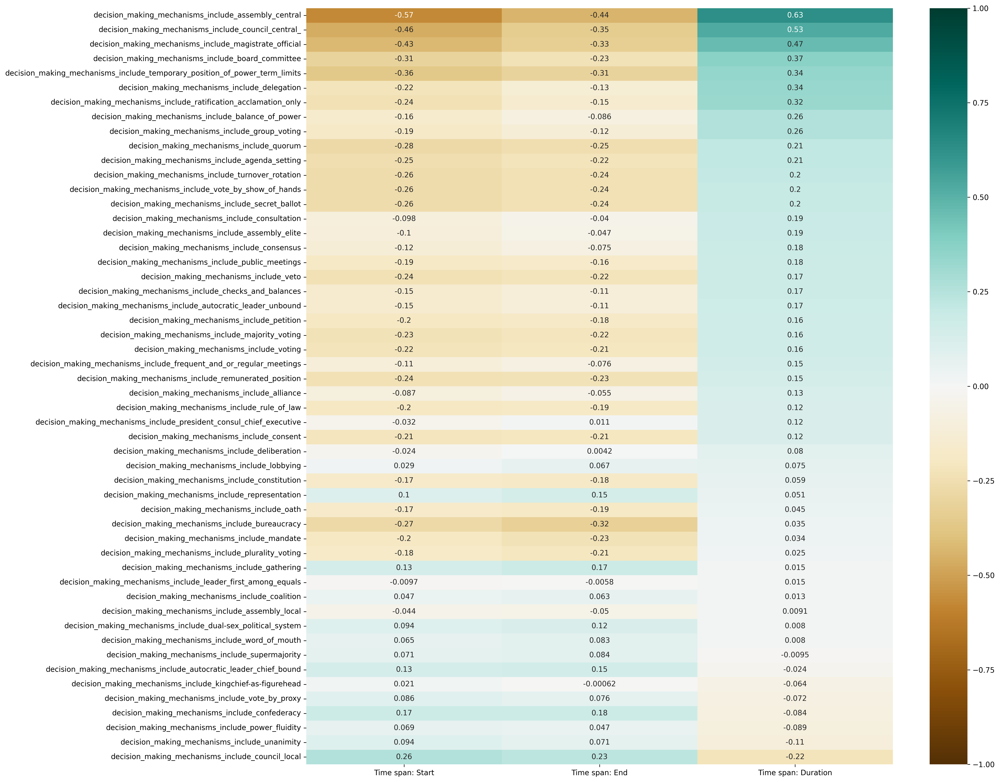

In [47]:
plt.figure(figsize=(20, 15))

sns.heatmap(time_decision_making_mechanisms.sort_values(by='Time span: Duration', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'time_decision_making_mechanisms.png')
plt.show()

In [48]:
time_enforcement_mechanisms = time_mechanisms.loc[enforcement_mechanisms]

In [ ]:
plt.figure(figsize=(15, 15))

sns.heatmap(time_enforcement_mechanisms.sort_values(by='Time span: Duration', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'time_enforcement_mechanisms.png')
plt.show()

# Region x Mechanism

In [50]:
region_cols = [r for r in list(gov_df) if 'Region: ' in r] 

In [51]:
region_cols

['Region: Africa',
 'Region: Europe',
 'Region: Asia',
 'Region: Middle East',
 'Region: North America',
 'Region: Central America',
 'Region: South America',
 'Region: Oceania']

In [52]:
region_mechanisms = query_mechanisms_df[region_cols]
region_mechanisms

,Region: Africa,Region: Europe,Region: Asia,Region: Middle East,Region: North America,Region: Central America,Region: South America,Region: Oceania
access_mechanisms_include_age_boundaries,0.003192,0.317736,-0.106163,-0.054866,-0.058185,-0.054493,0.031031,-0.055129
access_mechanisms_include_blood_relations,0.517481,0.009437,0.127874,-0.078301,-0.072403,0.024148,-0.009157,0.043380
access_mechanisms_include_child_participation,-0.070531,-0.090752,-0.099507,-0.051426,0.303312,-0.051076,-0.045773,0.186300
access_mechanisms_include_co-optation,-0.060436,0.095553,-0.085264,-0.044065,-0.084707,-0.043766,-0.039221,-0.044277
access_mechanisms_include_divine_right,0.085585,-0.089928,-0.098604,0.087616,0.050251,-0.050613,-0.045357,-0.051204
access_mechanisms_include_dreaming,-0.060688,-0.078087,0.133418,-0.044249,0.082270,-0.043948,-0.039385,-0.044462
access_mechanisms_include_election,0.241253,0.761294,-0.118019,-0.107563,-0.100992,-0.051126,-0.095739,-0.108079
access_mechanisms_include_enfranchisement,-0.049300,0.342046,-0.069554,-0.035946,-0.069099,-0.035701,-0.031994,-0.036118
access_mechanisms_include_female_participation,0.096260,-0.160288,-0.131597,-0.132458,0.266098,-0.131557,-0.117898,0.166826
access_mechanisms_include_gerontocracy,-0.063393,-0.058292,-0.000992,-0.102080,0.226031,-0.108167,-0.037887,0.070543


In [53]:
# Move Region: Europe to first col 
cols_to_move = ['Region: Europe']
region_mechanisms = region_mechanisms[cols_to_move + [col for col in region_mechanisms.columns if col not in cols_to_move]]

In [ ]:
plt.figure(figsize=(40, 30))

sns.heatmap(region_mechanisms.sort_values(by='Region: Europe', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'region_mechanisms.png')
plt.show()

### Region x Mechanism: Access, Decision Making, Enforcement

In [ ]:
region_access_mechanisms = region_mechanisms.loc[access_mechanisms]

In [ ]:
plt.figure(figsize=(20, 15))

sns.heatmap(region_access_mechanisms.sort_values(by='Region: Europe', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'region_access_mechanisms.png')
plt.show()

In [ ]:
region_decision_making_mechanisms = region_mechanisms.loc[decision_making_mechanisms]

In [58]:
plt.figure(figsize=(40, 30))

sns.heatmap(region_decision_making_mechanisms.sort_values(by='Region: Europe', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'region_decision_making_mechanisms.png')
plt.show()

In [59]:
region_enforcement_mechanisms = region_mechanisms.loc[enforcement_mechanisms]

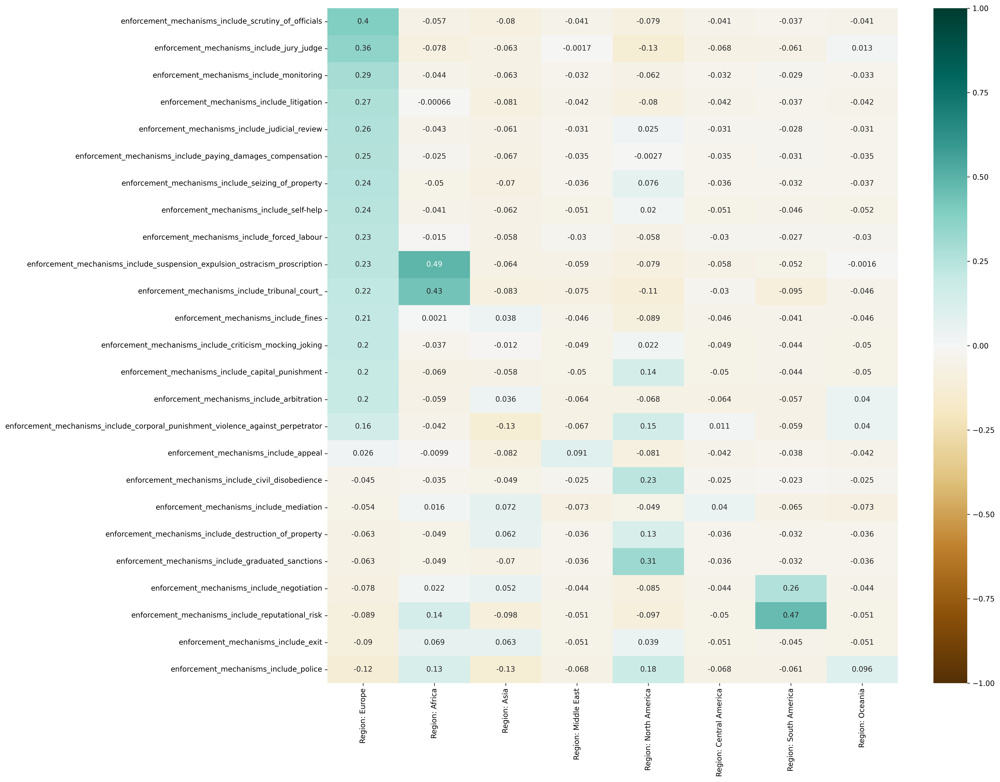

In [60]:
plt.figure(figsize=(20, 15))

sns.heatmap(region_enforcement_mechanisms.sort_values(by='Region: Europe', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'region_enforcement_mechanisms.png')
plt.show()

# Size x Mechanism

In [61]:
size_cols = [
    'Size: 100 - 1,000',
    'Size: 1,001 - 10,000',
    'Size: 10,001 - 100,000',
    'Size: 100,001 - 1,000,000',
    'Size: 1,000,001 - 10,000,000',
    'Size: 10,000,000+',
    'Size: Unknown'
]

In [62]:
size_mechanisms = query_mechanisms_df[size_cols]

In [63]:
norm_corr[size_cols].head()

,"Size: 100 - 1,000","Size: 1,001 - 10,000","Size: 10,001 - 100,000","Size: 100,001 - 1,000,000","Size: 1,000,001 - 10,000,000","Size: 10,000,000+",Size: Unknown
Time span: Start,0.152766,0.069685,-0.226465,-0.300560,-0.150699,-0.098158,-0.043318
Time span: End,0.112514,0.016018,-0.161793,-0.222625,-0.058637,-0.070542,-0.004610
is_SCCS,0.258152,0.178656,-0.228504,-0.103674,-0.142015,-0.123673,-0.020773
decision_making_mechanisms_include_representation,0.047554,-0.028141,-0.087220,-0.122188,0.024967,0.043117,0.017858
enforcement_mechanisms_include_police,-0.068745,0.007140,-0.038547,-0.070625,0.134782,-0.055861,-0.075272


In [64]:
norm_corr[size_cols].to_csv('../csv/' + DATA_VERSION + '/size_correlations.csv')

In [ ]:
plt.figure(figsize=(40, 30))

sns.heatmap(size_mechanisms,
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'size_mechanisms.png')
plt.show()

### Size x Mechanism: Access, Decision Making, Enforcement

In [66]:
size_access_mechanisms = size_mechanisms.loc[access_mechanisms]

In [ ]:
plt.figure(figsize=(20, 15))

sns.heatmap(size_access_mechanisms,
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'size_access_mechanisms.png')
plt.show()

In [68]:
size_decision_making_mechanisms = size_mechanisms.loc[decision_making_mechanisms]

In [ ]:
plt.figure(figsize=(20, 15))

sns.heatmap(size_decision_making_mechanisms,
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'size_decision_making_mechanisms.png')
plt.show()

In [70]:
size_enforcement_mechanisms = size_mechanisms.loc[enforcement_mechanisms]

In [ ]:
plt.figure(figsize=(20, 15))

sns.heatmap(size_enforcement_mechanisms,
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'size_enforcement_mechanisms.png')
plt.show()

# Query and sort for mechanisms

In [ ]:
def query_mech(col_name, ascending=False):
    # Return a sorted frame for a single column
    return query_mechanisms_df[col_name].sort_values(ascending=ascending)

In [ ]:
query_mechanisms_df['Time span: Start'].sort_values(ascending=False)

access_mechanisms_include_meritocracy                                              0.292762
decision_making_mechanisms_include_council_local                                   0.262913
access_mechanisms_include_life_appointment                                         0.207073
access_mechanisms_include_matrilineality                                           0.181055
decision_making_mechanisms_include_confederacy                                     0.172202
access_mechanisms_include_popularity_                                              0.166904
enforcement_mechanisms_include_mediation                                           0.163874
access_mechanisms_include_female_participation                                     0.162806
access_mechanisms_include_child_participation                                      0.137106
decision_making_mechanisms_include_gathering                                       0.134943
access_mechanisms_include_induction_rite_ceremony                               

In [74]:
query_mech('Time span: Duration')

decision_making_mechanisms_include_assembly_central                                0.630082
decision_making_mechanisms_include_council_central_                                0.525288
decision_making_mechanisms_include_magistrate_official                             0.466085
access_mechanisms_include_election                                                 0.426268
decision_making_mechanisms_include_board_committee                                 0.374639
decision_making_mechanisms_include_temporary_position_of_power_term_limits         0.336817
decision_making_mechanisms_include_delegation                                      0.335499
decision_making_mechanisms_include_ratification_acclamation_only                   0.324676
access_mechanisms_include_property_requirement                                     0.301409
access_mechanisms_include_blood_relations                                          0.300199
enforcement_mechanisms_include_forced_labour                                    

In [75]:
query_mech('Time span: Duration', ascending=True)

access_mechanisms_include_meritocracy                                             -0.225651
decision_making_mechanisms_include_council_local                                  -0.219971
access_mechanisms_include_life_appointment                                        -0.191253
access_mechanisms_include_matrilineality                                          -0.175593
access_mechanisms_include_child_participation                                     -0.167018
access_mechanisms_include_female_participation                                    -0.161063
access_mechanisms_include_popularity_                                             -0.149101
access_mechanisms_include_dreaming                                                -0.136390
enforcement_mechanisms_include_negotiation                                        -0.124050
enforcement_mechanisms_include_exit                                               -0.118154
enforcement_mechanisms_include_graduated_sanctions                              

In [76]:
plt.figure(figsize=(60, 60))

# define the mask to set the values in the upper triangle to True
mask = np.triu(np.ones_like(norm_corr, dtype=np.bool))

triangle_heatmap = sns.heatmap(
    norm_corr, 
    mask=mask, 
    vmin=-1, 
    vmax=1, 
    annot=False, 
    cmap='BrBG', 
    xticklabels=1, 
    yticklabels=1)

triangle_heatmap.set_title('Correlations: Community Mechanisms', fontdict={'fontsize':18}, pad=16);

plt.tight_layout()
plt.savefig(fig_dir + 'mechanisms_triangle_correlations.png')
plt.show()

/var/folders/v7/8x_7ty4j3m76hgg7tncks_kc0000gn/T/ipykernel_68628/4156542858.py:4: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  mask = np.triu(np.ones_like(norm_corr, dtype=np.bool))


In [77]:
plt.figure(figsize=(20,50))

heatmap = sns.heatmap(
    norm_corr[['Time span: Duration']].dropna().sort_values(
        by='Time span: Duration', 
        ascending=False), 
    vmin=-1, 
    vmax=1, 
    annot=True, 
    annot_kws={"size": 8},
    xticklabels=1, 
    yticklabels=1, 
    cmap='BrBG')

heatmap.set_title('Features Correlating with Time span: Duration', fontdict={'fontsize':18}, pad=16);

plt.tight_layout()
plt.savefig(fig_dir + 'duration_correlations.png')
plt.show()

# Time x Region x Size

In [78]:
norm_corr[time_span_cols + region_cols + size_cols]

,Time span: Start,Time span: End,Time span: Duration,Region: Africa,Region: Europe,Region: Asia,Region: Middle East,Region: North America,Region: Central America,Region: South America,Region: Oceania,"Size: 100 - 1,000","Size: 1,001 - 10,000","Size: 10,001 - 100,000","Size: 100,001 - 1,000,000","Size: 1,000,001 - 10,000,000","Size: 10,000,000+",Size: Unknown
Time span: Start,1.000000,0.950484,-0.669968,-0.080730,-0.407977,-0.092189,-0.351797,0.276504,0.110000,0.128310,0.144303,0.152766,0.069685,-0.226465,-0.300560,-0.150699,-0.098158,-0.043318
Time span: End,0.950484,1.000000,-0.406080,-0.027035,-0.290600,-0.081579,-0.343641,0.224620,0.133777,0.104680,0.118284,0.112514,0.016018,-0.161793,-0.222625,-0.058637,-0.070542,-0.004610
is_SCCS,0.376647,0.310753,-0.365201,0.009134,-0.267187,-0.148153,-0.151405,0.254950,-0.065553,0.239662,0.375177,0.258152,0.178656,-0.228504,-0.103674,-0.142015,-0.123673,-0.020773
decision_making_mechanisms_include_representation,0.103002,0.148020,0.050715,0.124155,-0.207640,0.252348,-0.141048,0.034457,-0.140088,-0.125543,-0.032397,0.047554,-0.028141,-0.087220,-0.122188,0.024967,0.043117,0.017858
enforcement_mechanisms_include_police,0.066147,0.083348,0.004599,0.129548,-0.120683,-0.132325,-0.068387,0.180048,-0.067922,-0.060869,0.095953,-0.068745,0.007140,-0.038547,-0.070625,0.134782,-0.055861,-0.075272
enforcement_mechanisms_include_fines,-0.129582,-0.154598,0.011727,0.002058,0.210356,0.038272,-0.046165,-0.088744,-0.045851,-0.041091,-0.046387,0.052375,-0.095961,-0.133307,0.278910,0.044666,0.019231,0.006083
decision_making_mechanisms_include_coalition,0.046502,0.062583,0.012760,-0.034675,0.071342,-0.048920,-0.025282,-0.048600,-0.025110,-0.022503,-0.025404,-0.025415,-0.052553,0.120361,-0.026110,-0.023714,-0.020651,-0.027828
decision_making_mechanisms_include_unanimity,0.094345,0.070588,-0.108798,-0.056574,-0.082163,-0.132966,-0.068718,0.425541,-0.068251,-0.061164,-0.069048,0.103900,0.105658,-0.079113,-0.070967,-0.013763,-0.056131,-0.075636
decision_making_mechanisms_include_bureaucracy,-0.274460,-0.323033,0.035379,0.030298,-0.001599,-0.069076,-0.035699,-0.068624,-0.035456,-0.031775,-0.035870,-0.035886,0.074722,-0.103085,-0.036867,0.073168,-0.029160,-0.039293
enforcement_mechanisms_include_reputational_risk,0.113609,0.107948,-0.076201,0.139993,-0.089350,-0.097970,-0.050632,-0.097330,-0.050287,0.466210,-0.050875,-0.050897,0.045754,-0.029818,0.003133,-0.047492,-0.041358,-0.055729


In [79]:
time_region_size = norm_corr[time_span_cols + region_cols + size_cols].loc[time_span_cols + region_cols + size_cols]

In [80]:
time_region_size

,Time span: Start,Time span: End,Time span: Duration,Region: Africa,Region: Europe,Region: Asia,Region: Middle East,Region: North America,Region: Central America,Region: South America,Region: Oceania,"Size: 100 - 1,000","Size: 1,001 - 10,000","Size: 10,001 - 100,000","Size: 100,001 - 1,000,000","Size: 1,000,001 - 10,000,000","Size: 10,000,000+",Size: Unknown
Time span: Start,1.000000,0.950484,-0.669968,-0.080730,-0.407977,-0.092189,-0.351797,0.276504,0.110000,0.128310,0.144303,0.152766,0.069685,-0.226465,-0.300560,-0.150699,-0.098158,-0.043318
Time span: End,0.950484,1.000000,-0.406080,-0.027035,-0.290600,-0.081579,-0.343641,0.224620,0.133777,0.104680,0.118284,0.112514,0.016018,-0.161793,-0.222625,-0.058637,-0.070542,-0.004610
Time span: Duration,-0.669968,-0.406080,1.000000,0.172809,0.505468,0.076206,0.213564,-0.276485,-0.003887,-0.127235,-0.141766,-0.180436,-0.166648,0.279430,0.351989,0.303063,0.120122,0.116366
Region: Africa,-0.080730,-0.027035,0.172809,1.000000,-0.139235,-0.152666,-0.078899,-0.151668,-0.078363,-0.070226,-0.079278,-0.079312,-0.041420,-0.108259,0.308121,0.013194,-0.064448,0.019200
Region: Europe,-0.407977,-0.290600,0.505468,-0.139235,1.000000,-0.196436,-0.101520,-0.195152,-0.100829,-0.090360,-0.102007,-0.102051,0.029239,0.248203,0.592660,0.221412,-0.082925,-0.047521
Region: Asia,-0.092189,-0.081579,0.076206,-0.152666,-0.196436,1.000000,-0.111313,-0.213978,-0.110556,-0.099077,-0.111847,-0.019085,-0.147011,-0.049132,-0.114956,-0.060082,0.625044,0.031909
Region: Middle East,-0.351797,-0.343641,0.213564,-0.078899,-0.101520,-0.111313,1.000000,-0.110586,-0.057136,-0.051204,-0.057804,-0.057829,-0.119578,0.101185,-0.022623,-0.053960,-0.046991,0.395612
Region: North America,0.276504,0.224620,-0.276485,-0.151668,-0.195152,-0.213978,-0.110586,1.000000,-0.109833,-0.098429,-0.111116,0.381250,0.191284,-0.152812,-0.114205,-0.103727,-0.090330,-0.121719
Region: Central America,0.110000,0.133777,-0.003887,-0.078363,-0.100829,-0.110556,-0.057136,-0.109833,1.000000,-0.050856,-0.057411,-0.057435,-0.046837,-0.164987,0.149014,-0.053593,-0.046671,-0.062889
Region: South America,0.128310,0.104680,-0.127235,-0.070226,-0.090360,-0.099077,-0.051204,-0.098429,-0.050856,1.000000,-0.051450,-0.051472,0.074403,-0.087254,0.008043,-0.048028,-0.041825,-0.056359


/var/folders/v7/8x_7ty4j3m76hgg7tncks_kc0000gn/T/ipykernel_68628/18854544.py:4: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  mask = np.triu(np.ones_like(time_region_size, dtype=np.bool))


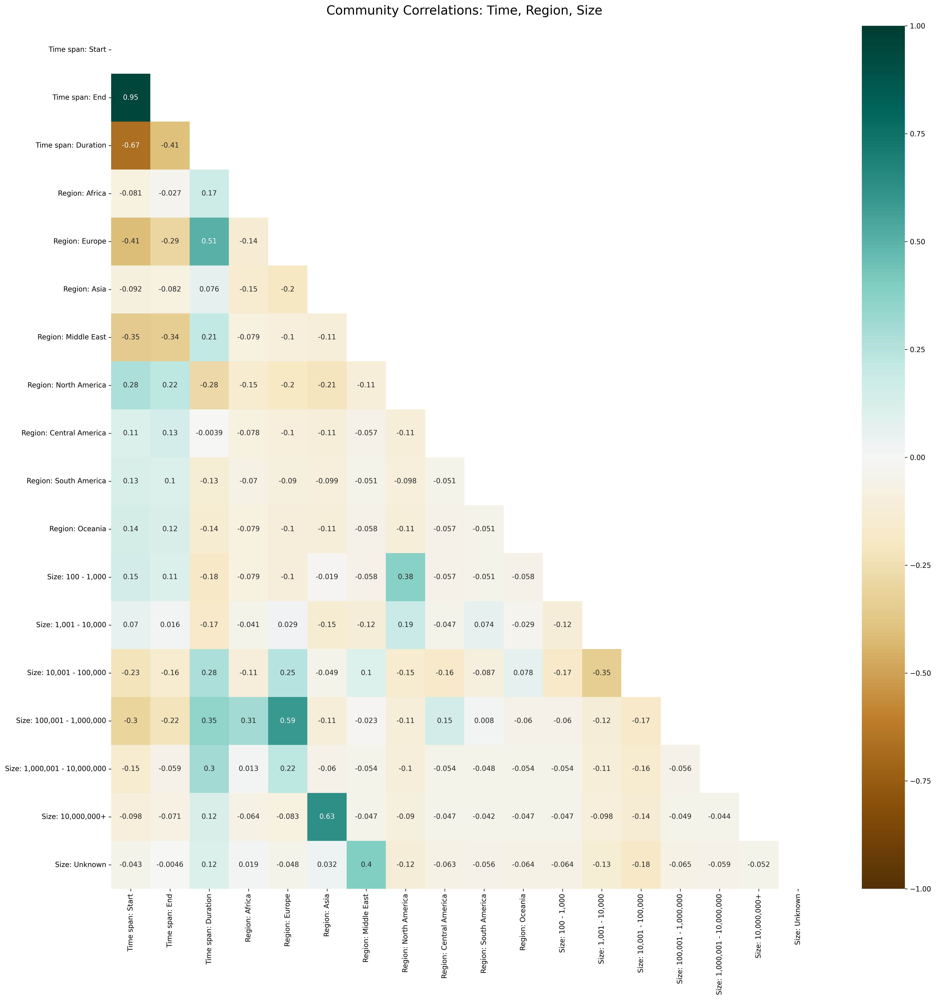

In [81]:
plt.figure(figsize=(20, 20))

# define the mask to set the values in the upper triangle to True
mask = np.triu(np.ones_like(time_region_size, dtype=np.bool))

triangle_heatmap = sns.heatmap(
    time_region_size, 
    mask=mask, 
    vmin=-1, 
    vmax=1, 
    annot=True, 
    cmap='BrBG', 
    xticklabels=1, 
    yticklabels=1)

triangle_heatmap.set_title('Community Correlations: Time, Region, Size', fontdict={'fontsize':18}, pad=16);

plt.tight_layout()
plt.savefig(fig_dir + 'communities_time_region_size.png')
plt.show()

## Time

In [82]:
time_corr = norm_corr[time_span_cols].loc[region_cols + size_cols]

In [83]:
time_corr

,Time span: Start,Time span: End,Time span: Duration
Region: Africa,-0.080730,-0.027035,0.172809
Region: Europe,-0.407977,-0.290600,0.505468
Region: Asia,-0.092189,-0.081579,0.076206
Region: Middle East,-0.351797,-0.343641,0.213564
Region: North America,0.276504,0.224620,-0.276485
Region: Central America,0.110000,0.133777,-0.003887
Region: South America,0.128310,0.104680,-0.127235
Region: Oceania,0.144303,0.118284,-0.141766
"Size: 100 - 1,000",0.152766,0.112514,-0.180436
"Size: 1,001 - 10,000",0.069685,0.016018,-0.166648


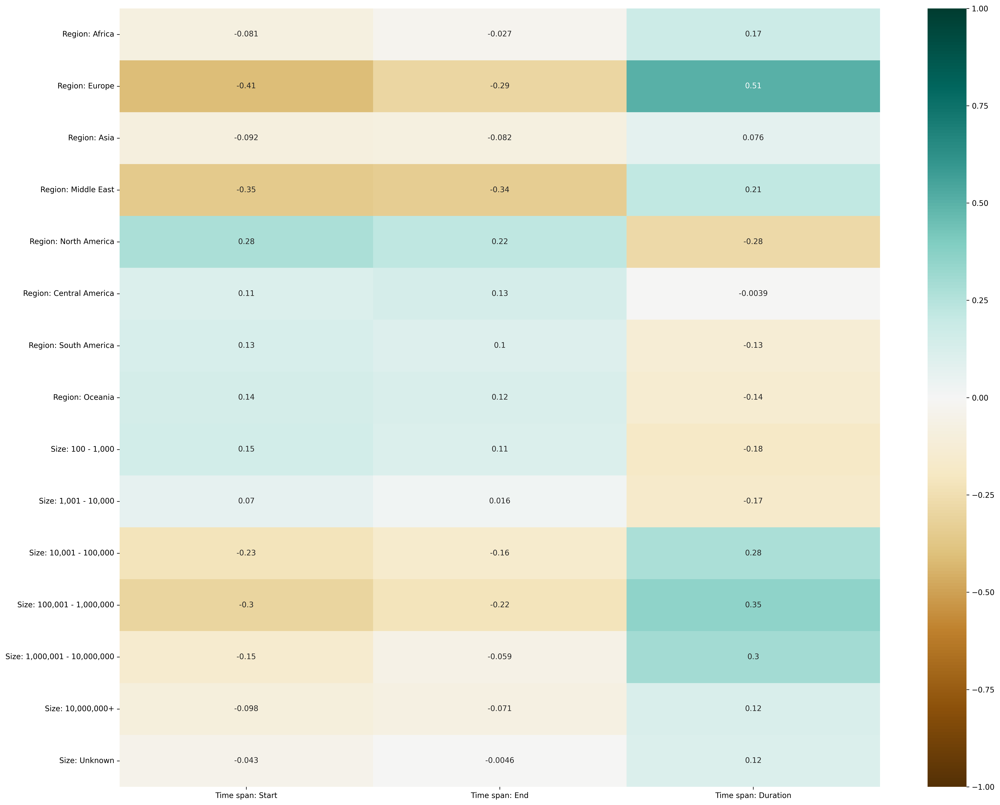

In [84]:
plt.figure(figsize=(20, 15))

sns.heatmap(time_corr,
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'communities_time_correlations.png')
plt.show()

## Region

In [85]:
region_corr = norm_corr[region_cols].loc[time_span_cols + size_cols]

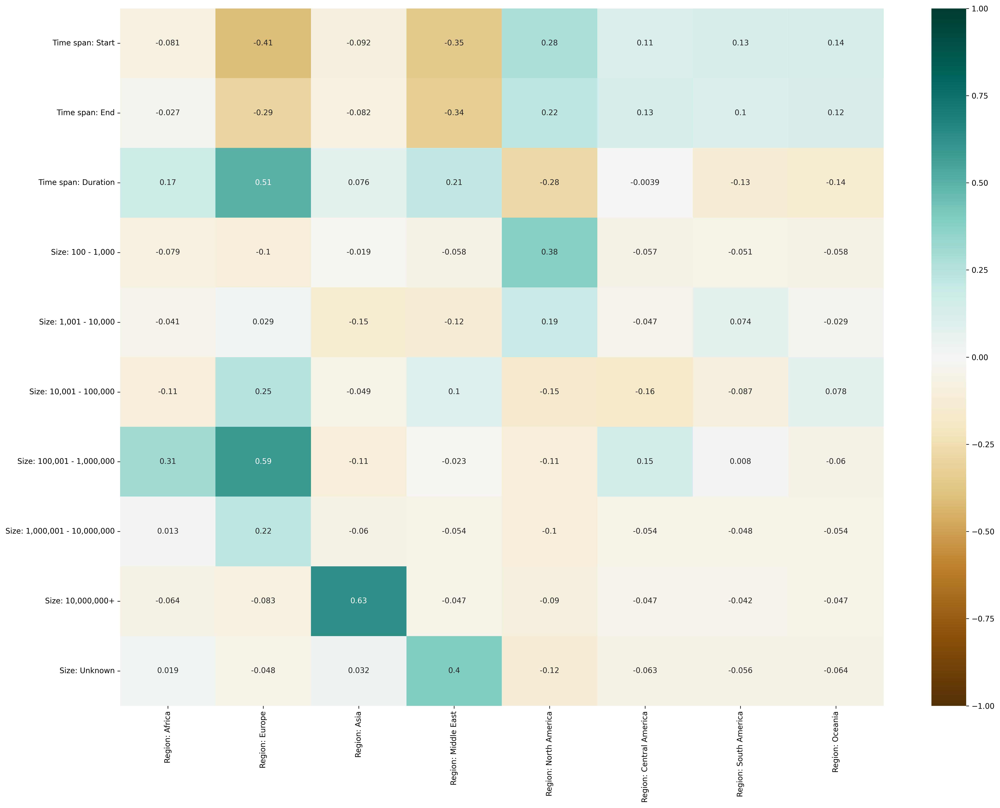

In [86]:
plt.figure(figsize=(20, 15))

sns.heatmap(region_corr,
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'communities_region_correlations.png')
plt.show()

## Size 

In [87]:
size_corr = norm_corr[size_cols].loc[time_span_cols + region_cols]

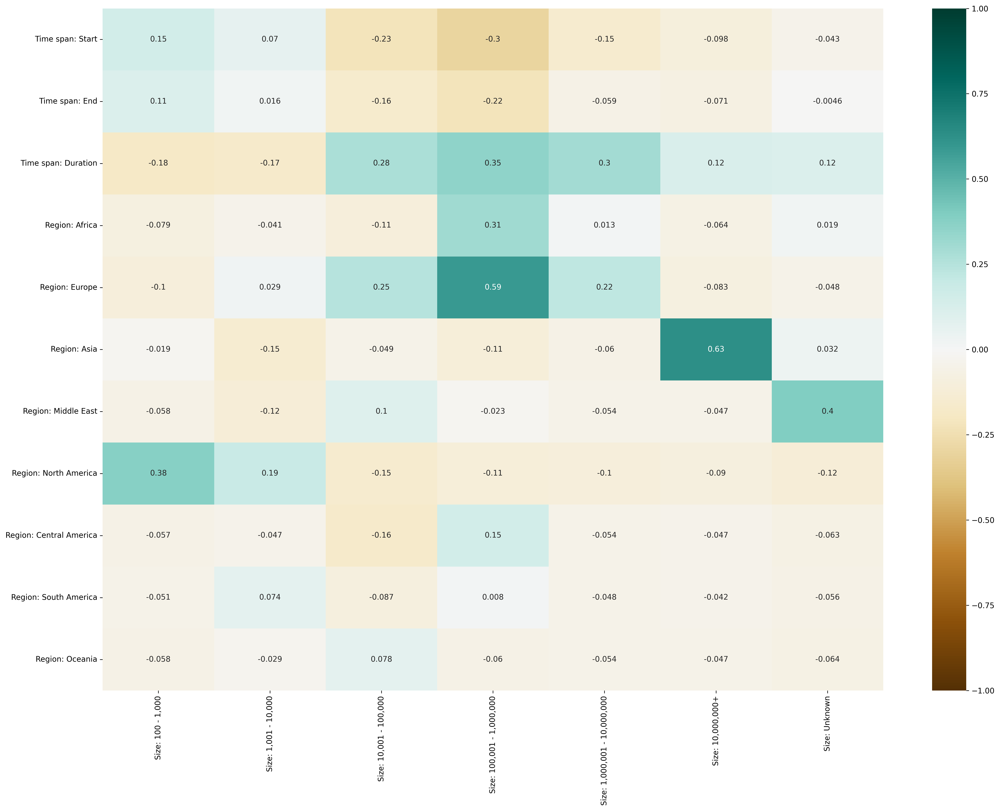

In [88]:
plt.figure(figsize=(20, 15))

sns.heatmap(size_corr,
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'communities_size_correlations.png')
plt.show()